# Architectural recovery of the Zeeguu API
- Backend of a web application that supports [free reading in foreign languages](https://zeeguu.org)
- Open source [repository on GH](https://github.com/zeeguu/API/)

# Basic Data Gathering

- extracting basic dependencies between python modules
- every .py file is called a module in Python
- direct relationship between file name and module name
  - file: `./zeeguu_core/model/user.py` <==>
  - module: `zeeguu_core.model.User`

This can easily be adapted to work with another repo.





In [2]:
# Installing Required Dependencies
import sys
sys.version
!{sys.executable} -m pip install gitpython
!{sys.executable} -m pip install pyvis
!{sys.executable} -m pip install matplotlib
!{sys.executable} -m pip install scipy


[notice] A new release of pip is available: 25.0.1 -> 25.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip


  Using cached pyvis-0.3.2-py3-none-any.whl.metadata (1.7 kB)
  Using cached jsonpickle-4.0.5-py3-none-any.whl.metadata (8.2 kB)
Using cached pyvis-0.3.2-py3-none-any.whl (756 kB)
Using cached jsonpickle-4.0.5-py3-none-any.whl (46 kB)



[notice] A new release of pip is available: 25.0.1 -> 25.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip



[notice] A new release of pip is available: 25.0.1 -> 25.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip



[notice] A new release of pip is available: 25.0.1 -> 25.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip



   ---------------------------------------- 0.0/41.0 MB ? eta -:--:--
   -- ------------------------------------- 2.6/41.0 MB 13.7 MB/s eta 0:00:03
   ----- ---------------------------------- 5.8/41.0 MB 15.3 MB/s eta 0:00:03
   -------- ------------------------------- 8.9/41.0 MB 15.8 MB/s eta 0:00:03
   ----------- ---------------------------- 11.8/41.0 MB 15.4 MB/s eta 0:00:02
   -------------- ------------------------- 14.9/41.0 MB 14.9 MB/s eta 0:00:02
   ----------------- ---------------------- 18.4/41.0 MB 15.4 MB/s eta 0:00:02
   --------------------- ------------------ 22.0/41.0 MB 15.6 MB/s eta 0:00:02
   ------------------------ --------------- 25.4/41.0 MB 15.6 MB/s eta 0:00:01
   --------------------------- ------------ 28.6/41.0 MB 15.5 MB/s eta 0:00:01
   ------------------------------- -------- 32.0/41.0 MB 15.6 MB/s eta 0:00:01
   ---------------------------------- ----- 35.4/41.0 MB 15.6 MB/s eta 0:00:01
   ------------------------------------- -- 38.8/41.0 MB 15.7 M

In [3]:
# In Collab our notebook runs in a temporary mounted file system
# Let's print the name of the folder where our script runs

import os
cwd = os.getcwd()
print(cwd)


c:\Users\eseme\Desktop\2.semester-CS\Architectural-recovery-SA


In [ ]:
# Let's declare a var for the path where we're going to download a repository
# Warning: this must end in /
# On windows this places the folder at C:/content/zeeguu-api/
CODE_ROOT_FOLDER="/content/zeeguu-api/"

In [5]:
from git import Repo
# GitPython is a library that allows us to work easily with git from Python
# https://gitpython.readthedocs.io/en/stable/tutorial.html


# If the file exists, it means we've already downloaded
if not os.path.exists(CODE_ROOT_FOLDER):
  Repo.clone_from("https://github.com/zeeguu/api", CODE_ROOT_FOLDER)


In [6]:
print(CODE_ROOT_FOLDER)

/content/zeeguu-api/


In [7]:
# helper function to get a file path w/o having to always provide the /content/zeeguu-api/ prefix
def file_path(file_name):
    return CODE_ROOT_FOLDER+file_name

assert (file_path("zeeguu/core/model/user.py") == "/content/zeeguu-api/zeeguu/core/model/user.py")


In [8]:
# extracting a module name from a file name
def module_name_from_file_path(full_path):

    # e.g. ../core/model/user.py -> zeeguu.core.model.user

    file_name = full_path[len(CODE_ROOT_FOLDER):]
    file_name = file_name.replace("/__init__.py","")
    file_name = file_name.replace("/",".")
    file_name = file_name.replace(".py","")
    return file_name

assert 'zeeguu.core.model.user' == module_name_from_file_path(file_path('zeeguu/core/model/user.py'))

In [ ]:
# naïve way of extracting imports using regular expressions
import re

# Enhanced import detection with full support for various import patterns
def import_from_line(line):
    """
    Extract imported module names from a Python import statement line.
    
    Args:
        line (str): A line of code potentially containing import statement
        
    Returns:
        list: List of imported module names or None if no imports found
    """
    # Remove any comments and trailing whitespace
    line = re.sub(r'#.*$', '', line).strip()
    
    # Skip if empty after comment removal
    if not line:
        return None
        
    # Case 1: from module import ...
    from_match = re.match(r'^from\s+(\S+)\s+import\s+(.+)$', line)
    if from_match:
        base_module = from_match.group(1)
        imported_items = from_match.group(2).split(',')
        
        # For a single import from a module, return that module
        # This maintains compatibility with the original function
        imported_item = imported_items[0].strip()
        
        # Handle 'as' alias
        if ' as ' in imported_item:
            imported_item = imported_item.split(' as ')[0].strip()
            
        # If importing specific attributes/submodules
        if imported_item != '*':
            return base_module
        
        return base_module
    
    # Case 2: import module [as alias], [module2 [as alias2]], ...
    import_match = re.match(r'^import\s+(.+)$', line)
    if import_match:
        modules = import_match.group(1).split(',')
        
        # For a single import, return that module
        # This maintains compatibility with the original function
        module = modules[0].strip()
        
        # Handle 'as' alias
        if ' as ' in module:
            module = module.split(' as ')[0].strip()
            
        return module
        
    return None

# extracts all the imported modules from a file
# returns a module of the form zeeguu_core.model.bookmark, e.g.
def imports_from_file(file):
    all_imports = []
    try:
        with open(file, encoding='utf-8') as f:
            lines = f.readlines()
    #Added the following since there are some of the files that throws a decode error and I cannot be bothered trying to salvage it, 
    # cp437 allows us to continue
    except UnicodeDecodeError:
        # Fallback to cp437 encoding if utf-8 fails
        with open(file, encoding='cp437') as f:
            lines = f.readlines()
            
    # Handle potential multi-line imports and joining them
    joined_lines = []
    current_line = ""
    
    for line in lines:
        line = line.strip()
        if not line or line.startswith('#'):
            # Skip empty lines and full comment lines
            if current_line:
                joined_lines.append(current_line)
                current_line = ""
            continue
            
        if current_line and (line.startswith("import ") or line.startswith("from ")):
            # This is a new import statement
            joined_lines.append(current_line)
            current_line = line
        elif current_line and (line.endswith(",") or "(" in current_line and ")" not in current_line):
            # This is a continuation of a multi-line import
            current_line += " " + line
        elif not current_line and (line.startswith("import ") or line.startswith("from ")):
            # This is the start of an import statement
            current_line = line
        elif current_line:
            # Append to current line
            current_line += " " + line
            if ")" in line and "(" in current_line:
                # End of a multi-line parenthesized import
                joined_lines.append(current_line)
                current_line = ""
                
    # Add the last line if it exists
    if current_line:
        joined_lines.append(current_line)
        
    # Process the joined lines
    for line in joined_lines:
        imp = import_from_line(line)
        if imp:
            all_imports.append(imp)
            
    return all_imports

# Example usage:
# imports_from_file(file_path('zeeguu/core/model/user.py'))
imports_from_file(file_path('zeeguu/core/model/user.py'))

['datetime',
 'json',
 'random',
 're',
 'sqlalchemy.orm',
 'zeeguu.core',
 'sqlalchemy',
 'sqlalchemy.orm',
 'sqlalchemy.orm.exc',
 'zeeguu.core.language.difficulty_estimator_factory',
 'zeeguu.core.model.language',
 'zeeguu.core.model.learning_cycle',
 'zeeguu.logging',
 'zeeguu.core.util',
 'zeeguu.core.model',
 'zeeguu.logging',
 'zeeguu.core.model.user_cohort_map',
 'zeeguu.core.model',
 'zeeguu.core.model.user_preference',
 'zeeguu.core.model',
 'zeeguu.core.model',
 'zeeguu.core.word_scheduling.basicSR.basicSR',
 'zeeguu.core.sql.queries.query_loader',
 'zeeguu.core.sql.query_building',
 'zeeguu.core.model.bookmark',
 'zeeguu.core.word_scheduling.basicSR.basicSR',
 'zeeguu.core.word_scheduling.basicSR.basicSR',
 'zeeguu.core.word_scheduling.basicSR.basicSR',
 'zeeguu.core.word_scheduling.basicSR.basicSR',
 'zeeguu.core.model.user_article',
 'dateutil.relativedelta',
 'zeeguu.core.model.user_cohort_map',
 'zeeguu.core.model',
 'zeeguu.core.model',
 'zeeguu.core.model.user_reading

In [10]:
# test
bookmark_imports = imports_from_file(file_path('zeeguu/core/model/bookmark.py'))
unique_code_imports =  imports_from_file(file_path('zeeguu/core/model/unique_code.py'))
print(bookmark_imports)
print(unique_code_imports)
assert(unique_code_imports != bookmark_imports)

['datetime', 'sqlalchemy', 'sqlalchemy', 'sqlalchemy.orm', 'sqlalchemy.orm.exc', 'zeeguu.core.model.caption', 'zeeguu.core.model.video', 'zeeguu.logging', 'zeeguu.core.bookmark_quality.fit_for_study', 'zeeguu.core.model.article', 'zeeguu.core.model.exercise', 'zeeguu.core.model.exercise_outcome', 'zeeguu.core.model.exercise_source', 'zeeguu.core.model.language', 'zeeguu.core.model.source', 'zeeguu.core.model.text', 'zeeguu.core.model.user', 'zeeguu.core.model.user_word', 'zeeguu.core.model.learning_cycle', 'zeeguu.core.model.bookmark_user_preference', 'zeeguu.core.model.bookmark_context', 'zeeguu.core.model', 'zeeguu.core.util.encoding', 'wordstats', 'zeeguu.core.word_scheduling', 'zeeguu.core.model.context_type', 'zeeguu.core.model.article', 'zeeguu.core.model.video', 'zeeguu.core.model.article_title_context', 'zeeguu.core.model.article_fragment_context', 'zeeguu.core.model.video_title_context', 'zeeguu.core.model.video_caption_context', 'zeeguu.logging', 'zeeguu.core.tokenization', '

# Now we extract the dependencies between all the files

To do that we iterate over all the python files with the help of the `Path.rglob` function from `pathlib`

And we create a network with the help of the `networkx` package.

In [14]:
import pathlib
from pathlib import Path
import networkx as nx

def dependencies_graph(code_root_folder):
    files = Path(code_root_folder).rglob("*.py")

    G = nx.Graph()

    for file in files:
        file_path = str(file)

        module_name = module_name_from_file_path(file_path)

        if module_name not in G.nodes:
            G.add_node(module_name)

        for each in imports_from_file(file_path):
            G.add_edge(module_name, each)

    return G

# Mathplotlib also has support for drawing networks

We do a simple drawing of all the files and their dependencies in our system

In [12]:
import matplotlib.pyplot as plt

# a function to draw a graph
def draw_graph(G: nx.Graph, size, **args):
    plt.figure(figsize=size)
    nx.draw(G, **args)
    plt.show()

# ------------------------ Claude generated visualization
import matplotlib.pyplot as plt
import networkx as nx
import numpy as np
from matplotlib.cm import get_cmap
from collections import defaultdict


# Original drawing function
def draw_graph(G: nx.Graph, size, **args):
    plt.figure(figsize=size)
    nx.draw(G, **args)
    plt.show()


# Enhanced dependency graph visualization
def visualize_dependencies(G, figsize=(18, 12), title="Code Dependency Graph", 
                           save_path=None, max_nodes_labeled=150, 
                           layout_type="kamada_kawai", group_by_module=True):
    """
    Create an enhanced visualization of a dependency graph.
    
    Args:
        G (nx.Graph): NetworkX graph of dependencies
        figsize (tuple): Figure size as (width, height)
        title (str): Title for the visualization
        save_path (str, optional): Path to save the image, if None, just displays
        max_nodes_labeled (int): Maximum number of nodes to show labels for
        layout_type (str): Layout algorithm to use ('spring', 'kamada_kawai', 'spectral', 'shell')
        group_by_module (bool): Whether to color nodes by top-level module
    
    Returns:
        The figure and positions dictionary
    """
    # Create figure
    fig, ax = plt.subplots(figsize=figsize)
    fig.suptitle(title, fontsize=16)
    
    # Check if the graph is too large
    num_nodes = len(G.nodes())
    if num_nodes > 1000:
        print(f"Warning: Large graph with {num_nodes} nodes. Visualization may be slow and cluttered.")
    
    # Compute node sizes based on importance
    # More connections = larger node
    node_degrees = dict(G.degree())
    # Logarithmic scaling to prevent too large differences
    node_sizes = {node: 50 + 100 * np.log1p(degree) for node, degree in node_degrees.items()}
    
    # Compute layout
    print(f"Computing {layout_type} layout...")
    if layout_type == "spring":
        pos = nx.spring_layout(G, seed=42, k=0.2)  # k controls spacing
    elif layout_type == "kamada_kawai":
        pos = nx.kamada_kawai_layout(G)
    elif layout_type == "spectral":
        pos = nx.spectral_layout(G)
    elif layout_type == "shell":
        pos = nx.shell_layout(G)
    else:
        pos = nx.spring_layout(G, seed=42)
    
    # Group nodes by top-level module if requested
    if group_by_module:
        # Extract top-level module from node name
        module_groups = defaultdict(list)
        for node in G.nodes():
            # Get first part of the module path
            top_module = node.split('.')[0] if '.' in node else node
            module_groups[top_module].append(node)
        
        # Get a colormap with enough colors
        colormap = get_cmap('tab20')  # 20 distinct colors
        colormap2 = get_cmap('Set3')  # Additional 12 colors if needed
        
        # Assign colors to modules
        num_modules = len(module_groups)
        if num_modules > 20:
            # Combine colormaps for more colors
            module_colors = {}
            for i, module in enumerate(module_groups.keys()):
                if i < 20:
                    module_colors[module] = colormap(i / 20)
                else:
                    module_colors[module] = colormap2((i - 20) / 12)
        else:
            module_colors = {module: colormap(i / 20) for i, module in enumerate(module_groups.keys())}
        
        # Create node colors list matching order of G.nodes()
        node_colors = []
        for node in G.nodes():
            top_module = node.split('.')[0] if '.' in node else node
            node_colors.append(module_colors[top_module])
            
        # Create a legend for module colors
        legend_handles = [plt.Line2D([0], [0], marker='o', color='w', 
                                     markerfacecolor=color, markersize=10, label=module) 
                         for module, color in module_colors.items()]
    else:
        # Default coloring by node centrality
        centrality = nx.betweenness_centrality(G)
        max_centrality = max(centrality.values()) if centrality else 1
        node_colors = [plt.cm.viridis(centrality[node]/max_centrality) for node in G.nodes()]
        legend_handles = []
    
    # Draw edges first so they're in the background
    nx.draw_networkx_edges(G, pos, alpha=0.2, width=0.5, edge_color='gray')
    
    # Draw nodes with computed sizes and colors
    nx.draw_networkx_nodes(G, pos, 
                           node_size=[node_sizes[node] for node in G.nodes()],
                           node_color=node_colors, 
                           alpha=0.8)
    
    # Only label nodes if there aren't too many
    if num_nodes <= max_nodes_labeled:
        # Compute label positions - slightly offset from nodes
        label_pos = {node: (coords[0], coords[1] + 0.02) for node, coords in pos.items()}
        
        # For larger graphs, only label the most important nodes
        if num_nodes > 50:
            # Determine most important nodes based on degree
            important_nodes = sorted(node_degrees, key=node_degrees.get, reverse=True)[:50]
            labels = {node: node for node in important_nodes}
        else:
            labels = {node: node for node in G.nodes()}
            
        nx.draw_networkx_labels(G, label_pos, labels=labels, font_size=8)
        
    # Add legend if grouped by module
    if group_by_module and legend_handles:
        # Put legend outside the main plot if there are many modules
        if len(legend_handles) > 10:
            plt.legend(handles=legend_handles, loc='upper left', 
                      bbox_to_anchor=(1.05, 1), fontsize=8)
        else:
            plt.legend(handles=legend_handles, loc='best', fontsize=8)
    
    # Add graph metrics as text
    metrics_text = f"Nodes: {num_nodes}\n"
    metrics_text += f"Edges: {len(G.edges())}\n"
    metrics_text += f"Connected Components: {nx.number_connected_components(G)}\n"
    
    # Calculate average degree
    avg_degree = sum(dict(G.degree()).values()) / num_nodes
    metrics_text += f"Avg. Degree: {avg_degree:.2f}\n"
    
    # Add density and diameter of largest component
    metrics_text += f"Graph Density: {nx.density(G):.4f}\n"
    
    # Find largest connected component
    largest_cc = max(nx.connected_components(G), key=len)
    largest_cc_subgraph = G.subgraph(largest_cc)
    metrics_text += f"Largest Component Size: {len(largest_cc)}\n"
    
    if len(largest_cc) > 1:  # Diameter requires at least 2 nodes
        try:
            diameter = nx.diameter(largest_cc_subgraph)
            metrics_text += f"Diameter of Largest Component: {diameter}"
        except nx.NetworkXError:
            # In case the graph is disconnected
            metrics_text += "Diameter: N/A (Disconnected Graph)"
    
    plt.figtext(0.02, 0.02, metrics_text, fontsize=10, 
                bbox=dict(facecolor='white', alpha=0.8))
    
    # Remove axis
    ax.axis('off')
    
    # Tight layout to make best use of space
    plt.tight_layout()
    
    # Save if requested
    if save_path:
        plt.savefig(save_path, dpi=300, bbox_inches='tight')
        print(f"Visualization saved to {save_path}")
    
    plt.show()
    return fig, pos


# Interactive visualization with hover info (requires plotly)
def interactive_dependency_graph(G, title="Interactive Dependency Graph", 
                                layout_type="kamada_kawai", group_by_module=True):
    """
    Create an interactive visualization of the dependency graph using Plotly.
    
    Args:
        G (nx.Graph): NetworkX graph of dependencies
        title (str): Title for the visualization
        layout_type (str): Layout algorithm to use
        group_by_module (bool): Whether to color nodes by top-level module
        
    Returns:
        Plotly figure that can be displayed in a notebook with fig.show()
    """
    try:
        import plotly.graph_objects as go
    except ImportError:
        print("Plotly is required for interactive visualization.")
        print("Install with: pip install plotly")
        return None
    
    # Compute layout
    if layout_type == "spring":
        pos = nx.spring_layout(G, seed=42)
    elif layout_type == "kamada_kawai":
        pos = nx.kamada_kawai_layout(G)
    elif layout_type == "spectral":
        pos = nx.spectral_layout(G)
    else:
        pos = nx.spring_layout(G, seed=42)
    
    # Compute node degrees for size
    node_degrees = dict(G.degree())
    node_sizes = {node: 5 + 3 * np.log1p(degree) for node, degree in node_degrees.items()}
    
    # Group by module if requested
    if group_by_module:
        module_groups = defaultdict(list)
        for node in G.nodes():
            top_module = node.split('.')[0] if '.' in node else node
            module_groups[top_module].append(node)
        
        # Create a color map
        import plotly.express as px
        colors = px.colors.qualitative.Plotly + px.colors.qualitative.Dark24
        module_colors = {}
        for i, module in enumerate(module_groups.keys()):
            module_colors[module] = colors[i % len(colors)]
    
    # Create edge traces
    edge_x = []
    edge_y = []
    for edge in G.edges():
        x0, y0 = pos[edge[0]]
        x1, y1 = pos[edge[1]]
        edge_x.extend([x0, x1, None])
        edge_y.extend([y0, y1, None])
    
    edge_trace = go.Scatter(
        x=edge_x, y=edge_y,
        line=dict(width=0.5, color='#888'),
        hoverinfo='none',
        mode='lines')
    
    # Create node traces, one for each module if grouping
    node_traces = []
    
    if group_by_module:
        for module, nodes in module_groups.items():
            node_x = []
            node_y = []
            node_text = []
            node_size = []
            
            for node in nodes:
                x, y = pos[node]
                node_x.append(x)
                node_y.append(y)
                # Include degree info in hover text
                node_text.append(f"{node}<br>Connections: {node_degrees[node]}")
                node_size.append(node_sizes[node])
            
            node_trace = go.Scatter(
                x=node_x, y=node_y,
                mode='markers',
                hoverinfo='text',
                text=node_text,
                marker=dict(
                    color=module_colors[module],
                    size=node_size,
                    line=dict(width=1, color='#444'),
                ),
                name=module  # This creates the legend entry
            )
            node_traces.append(node_trace)
    else:
        # Single trace with coloring by degree
        node_x = []
        node_y = []
        node_text = []
        node_size = []
        node_color = []
        
        for node in G.nodes():
            x, y = pos[node]
            node_x.append(x)
            node_y.append(y)
            node_text.append(f"{node}<br>Connections: {node_degrees[node]}")
            node_size.append(node_sizes[node])
            node_color.append(node_degrees[node])
        
        node_trace = go.Scatter(
            x=node_x, y=node_y,
            mode='markers',
            hoverinfo='text',
            text=node_text,
            marker=dict(
                size=node_size,
                color=node_color,
                colorscale='Viridis',
                colorbar=dict(title='Node Connections'),
                line=dict(width=1, color='#444')
            )
        )
        node_traces = [node_trace]
    
    # Create the figure
    fig = go.Figure(
        data=[edge_trace] + node_traces,
        layout=go.Layout(
            title=title,
            showlegend=group_by_module,
            hovermode='closest',
            margin=dict(b=20, l=5, r=5, t=40),
            xaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
            yaxis=dict(showgrid=False, zeroline=False, showticklabels=False)
        )
    )
    
    return fig


# Example usage:
"""
# Static visualization with module coloring
G = dependencies_graph(CODE_ROOT_FOLDER)
visualize_dependencies(G, 
                      figsize=(20, 16), 
                      title="Project Dependencies", 
                      group_by_module=True,
                      layout_type="kamada_kawai",
                      save_path="dependency_graph.png")

# Interactive visualization (requires plotly)
fig = interactive_dependency_graph(G, 
                                  title="Interactive Project Dependencies",
                                  group_by_module=True)
fig.show()
"""


'\n# Static visualization with module coloring\nG = dependencies_graph(CODE_ROOT_FOLDER)\nvisualize_dependencies(G, \n                      figsize=(20, 16), \n                      title="Project Dependencies", \n                      group_by_module=True,\n                      layout_type="kamada_kawai",\n                      save_path="dependency_graph.png")\n\n# Interactive visualization (requires plotly)\nfig = interactive_dependency_graph(G, \n                                  title="Interactive Project Dependencies",\n                                  group_by_module=True)\nfig.show()\n'

Computing kamada_kawai layout...


C:\Users\eseme\AppData\Local\Temp\ipykernel_7932\2014949398.py:81: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.

C:\Users\eseme\AppData\Local\Temp\ipykernel_7932\2014949398.py:82: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.

C:\Users\eseme\AppData\Local\Temp\ipykernel_7932\2014949398.py:179: UserWarning:

Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.



Visualization saved to dependency_graph.png


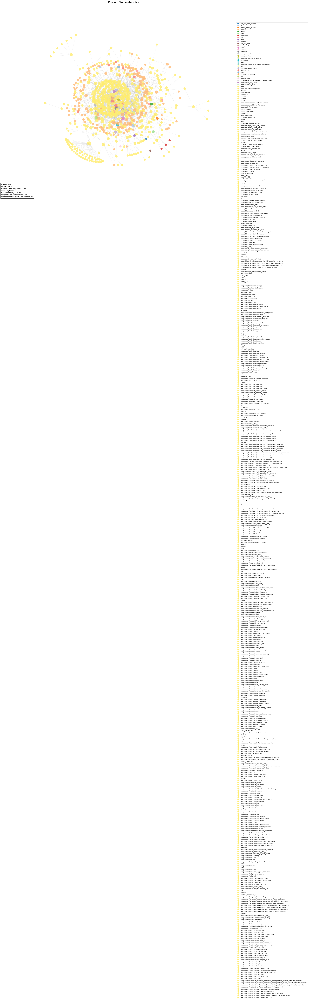

ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

In [18]:
G = dependencies_graph(CODE_ROOT_FOLDER)
draw_graph(G, (80,80), with_labels=True)

visualize_dependencies(G, 
                      figsize=(20, 16), 
                      title="Project Dependencies", 
                      group_by_module=True,
                      layout_type="kamada_kawai",
                      save_path="dependency_graph.png")

# Interactive visualization (requires plotly)
fig = interactive_dependency_graph(G, 
                                  title="Interactive Project Dependencies",
                                  group_by_module=True)
fig.show()

ModuleNotFoundError: No module named 'pandas'

In [ ]:
# However, if we think a bit more about it, we realize tat a dependency graph
# is a directed graph (e.g. module A depends on m)
# with any kinds of graph either directed (nx.DiGraph) or
# non-directed (nx.Graph)

def dependencies_digraph(code_root_folder):
    files = Path(code_root_folder).rglob("*.py")

    G = nx.DiGraph()

    for file in files:
        file_path = str(file)

        source_module = module_name_from_file_path(file_path)

        if source_module not in G.nodes:
            G.add_node(source_module)

        for target_module in imports_from_file(file_path):

            G.add_edge(source_module, target_module)
            # print(module_name + "=>" + each + ".")

    return G


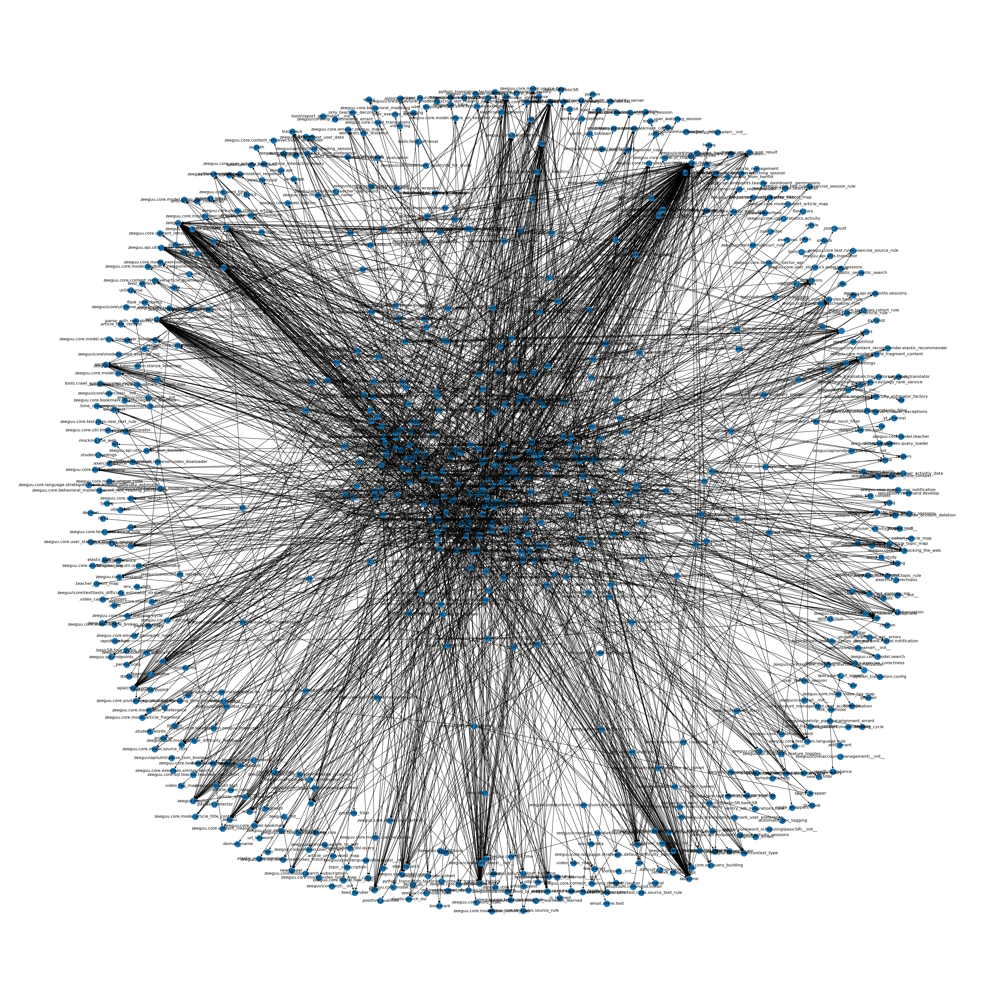

In [ ]:
# Looking at the directed graph
DG = dependencies_digraph(CODE_ROOT_FOLDER)
draw_graph(DG, (40,40), with_labels=True)